<a href="https://colab.research.google.com/github/Laofin050/Tugas-Praktikum_049-050/blob/main/Praktikum_kelompok_modul4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Soal Praktikum Overfitting Handling #2**

## Kegiatan 2 **(berkelompok)**
30 poin

**Ketentuan Wajib**
* Tulis dokumentasi tugas kelompok anda dalam file README.md
* Cek daftar dataset seluruh praktikan [disini](https://docs.google.com/spreadsheets/d/1qyu5AVDhPhegpRTbNaDoq5qXX4_CX09Q7tYyD-fkF_c/edit?usp=sharing)
* Seluruh data dan progress pengerjaan tugas kelompok harus berada dalam github repository sebelum praktikum dimulai
* Tidak diperbolehkan berganti anggota kelompok selama satu semester ini
* Tidak diperbolehkan berganti repository selama mengerjakan tugas kelompok ini
* **Tidak diperbolehkan berganti dataset atau jurnal rujukan**
* Pastikan anda menggunakan akun github pribadi untuk melakukan commit dan push

**Penilaian**
* Keaktifan dalam tim
* Kontribusi dalam proyek dan tim
* Penerapan prinsip kerja Agile (sprint backlog dan report terdokumentasikan dengan baik)
* Progress pengerjaan tugas kelompok
* Problem solving masing - masing anggota terhadap kendala yang dialami
* Pemahaman masing - masing anggota tim terhadap tugas yang dikerjakan
* Pendokumentasian proyek "clear and clean documentation"

**Materi pendukung**
* [Project documentation](https://realpython.com/documenting-python-code)
* [Github readme](https://docs.github.com/en/github/writing-on-github/getting-started-with-writing-and-formatting-on-github/basic-writing-and-formatting-syntax)
* [Sprint backlog](https://www.lucidchart.com/blog/how-to-develop-a-product-backlog-in-agile)

**Tugas**

Melanjutkan tugas kelompok di modul 1 sampai 3 sekarang kerjakan beberapa poin berikut untuk didemokan kepada asisten masing-masing.

*   Melakukan proses preprocessing dataset dengan ketentuan:
 * augmentasi data menggunakan ImageDataGenerator
 * balancing dataset menggunakan teknik oversampling / downsampling
 * splitting dataset menjadi (75% train, 14% validation, 1% test)
*   Melakukan training beberapa skema model menggunakan model CNN sederhana buatan sendiri **(minimal 2 model)** *tidak diperbolehkan menggunakan transfer learning* 
 * Menerapkan proses Convolution
 * Menerapkan proses Pooling
 * Menerapkan Dropout
 * Menerpakan BatchNormalization
 * Menerapkan learning rate scheduller
 * Menggunakan hyperparameter tuning
 * Minimal 100 epoch per model
* Menyimpan model yang telah di training kedalam file `.json` dan weight kedalam file `.h5` [Lihat disini](https://www.tensorflow.org/guide/keras/save_and_serialize)
*  Mencatat hasil perkembangan tugas kelompok dalam file `sprint_project.xlsx` tandai masing-masing task dengan status **Done** *untuk task yang telah selesai dikerjakan*, **On Going** *untuk task yang dalam proses pengerjaan*, **Waiting** *untuk task yang belum atau akan dikerjakan*
* Pastikan anda menulis tanggal mulai dan tanggal selesai masing-masing task dengan benar
* Pastikan anda menulis penanggung jawab masing-masing task (Penanggung jawab bertugas menyelesaikan dan menuntaskan masing-masing task yang diberikan)
* `commit` dan `push` seluruh perkerjaan yang anda lakukan kedalam branch pribadi dalam repository tugas kelompok yang telah anda buat sebelumnya.
* Presentasikan kepada asisten tentang apa yang anda lakukakan selama mengerjakan tugas kelompok ini. Ceritakan tentang tugas masing-masing anggota,  kendala dalam mengerjakan tugas sampai solusi yang anda lakukan saat mengerjakan tugas kelompok ini.



In [ ]:
# Tulis Program Anda Disini!
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
os.environ['KAGGLE_CONFIG_DIR'] = "/content/drive/MyDrive/Praktikum"

In [ ]:
%cd /content/drive/MyDrive/Praktikum

/content/drive/MyDrive/Praktikum


In [ ]:
ls

kaggle.json


In [ ]:
%rm -rf logs/
%rm -rf chest_xray/

In [ ]:
!kaggle datasets download -d paultimothymooney/chest-xray-pneumonia

100% 2.29G/2.29G [00:47<00:00, 65.6MB/s]
100% 2.29G/2.29G [00:47<00:00, 52.2MB/s]


In [ ]:
ls

chest-xray-pneumonia.zip  kaggle.json


In [ ]:
!unzip \chest-xray-pneumonia.zip &> /dev/null && rm chest-xray-pneumonia.zip

In [ ]:
!ls

chest_xray  kaggle.json


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import keras
from keras.models import Sequential
from keras.layers import Dense, Conv2D , MaxPool2D , Flatten , Dropout , BatchNormalization, AveragePooling2D
from keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report,confusion_matrix
from keras.callbacks import ReduceLROnPlateau
import cv2
import os
import numpy as np

In [ ]:
from os import mkdir

mkdir('/content/x-ray')
mkdir('/content/x-ray/NORMAL')
mkdir('/content/x-ray/PNEUMONIA')

In [ ]:
import os
import shutil

NORMAL_train = "/content/drive/MyDrive/Praktikum/chest_xray/chest_xray/train/NORMAL"
NORMAL_new = "/content/x-ray/NORMAL"

files = os.listdir(NORMAL_train)

for file in files[0:int(len(files))]:
  new_path = shutil.move(f"{NORMAL_train}/{file}", NORMAL_new)

In [ ]:
import os
import shutil

NORMAL_test = "/content/drive/MyDrive/Praktikum/chest_xray/chest_xray/test/NORMAL"
NORMAL_new = "/content/x-ray/NORMAL"

files = os.listdir(NORMAL_test)

for file in files[0:int(len(files))]:
  new_path = shutil.move(f"{NORMAL_test}/{file}", NORMAL_new)

In [ ]:
import os
import shutil

PNEUMONIA_train = "/content/drive/MyDrive/Praktikum/chest_xray/chest_xray/train/PNEUMONIA"
PNEUMONIA_new = "/content/x-ray/PNEUMONIA"

files = os.listdir(PNEUMONIA_train)

for file in files[0:int(len(files))]:
  new_path = shutil.move(f"{PNEUMONIA_train}/{file}", PNEUMONIA_new)

In [ ]:
import os
import shutil

PNEUMONIA_test = "/content/drive/MyDrive/Praktikum/chest_xray/chest_xray/test/PNEUMONIA"
PNEUMONIA_new = "/content/x-ray/PNEUMONIA"

files = os.listdir(PNEUMONIA_test)

for file in files[0:int(len(files))]:
  new_path = shutil.move(f"{PNEUMONIA_test}/{file}", PNEUMONIA_new)

In [ ]:
import numpy as np
import pandas as pd
import os
from shutil import copyfile

mkdir('/content/kaggle')

TRAIN_DIR = "/content/kaggle/train/"
VALID_DIR ="/content/kaggle/valid/"
TEST_DIR ="/content/kaggle/test/"

os.mkdir(TRAIN_DIR)
os.mkdir(VALID_DIR)
os.mkdir(TEST_DIR)

for label in ['NORMAL', 'PNEUMONIA']:
    os.mkdir(TRAIN_DIR+label)
    os.mkdir(VALID_DIR+label)
    os.mkdir(TEST_DIR+label)


**split data**

In [ ]:
# TULIS KODE ANDA DISINI
import random

def train_valid_test_split(source, train_dir, valid_dir, test_dir,train_size, valid_size, test_size):
    # get files
    files = []
    for filename in os.listdir(source):
        file = source + filename
        if os.path.getsize(file) > 0:
            files.append(filename)
    
    # train valid split

    train_size = int(len(files) * (1 - (valid_size + train_size)))
    valid_size = int(len(files)* (1 - (valid_size + test_size)))
    test_size = int(len(files)* (1 - train_size))
    
    # shuffle the dataset
    shuffled_files = random.sample(files, len(files))  

    train_set = shuffled_files[train_size:valid_size]
    valid_set = shuffled_files[valid_size:]
    test_set = shuffled_files[:train_size]
    
    for filename in train_set:
        filepath = source + filename
        destination = train_dir + filename
        copyfile(filepath, destination)
        
    for filename in valid_set:
        filepath = source + filename
        destination = valid_dir + filename
        copyfile(filepath, destination)
    
    for filename in test_set:
        filepath = source + filename
        destination = test_dir + filename
        copyfile(filepath, destination)

SOURCE = "/content/x-ray/"

for label in ['NORMAL', 'PNEUMONIA']:
    print(label)
    train_valid_test_split(SOURCE+label+'/', TRAIN_DIR +label+'/', VALID_DIR +label+'/', TEST_DIR +label+'/', train_size=0.8, valid_size=0.19, test_size=0.01)
    print(len(os.listdir(TRAIN_DIR +label+'/')))
    print(len(os.listdir(VALID_DIR +label+'/')))
    print(len(os.listdir(TEST_DIR +label+'/')))

NORMAL
1245
316
15
PNEUMONIA
3370
854
42


In [ ]:
labels = ['PNEUMONIA', 'NORMAL']
img_size = 150
def get_training_data(data_dir):
    data = [] 
    for label in labels: 
        path = os.path.join(data_dir, label)
        class_num = labels.index(label)
        for img in os.listdir(path):
            try:
                img_arr = cv2.imread(os.path.join(path, img), cv2.IMREAD_GRAYSCALE)
                resized_arr = cv2.resize(img_arr, (img_size, img_size)) # Reshaping images to preferred size
                data.append([resized_arr, class_num])
            except Exception as e:
                print(e)
    return np.array(data)

In [ ]:
train = get_training_data (TRAIN_DIR)
test = get_training_data (TEST_DIR)
val = get_training_data (VALID_DIR)

OpenCV(4.1.2) /io/opencv/modules/imgproc/src/resize.cpp:3720: error: (-215:Assertion failed) !ssize.empty() in function 'resize'



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  from ipykernel import kernelapp as app


OpenCV(4.1.2) /io/opencv/modules/imgproc/src/resize.cpp:3720: error: (-215:Assertion failed) !ssize.empty() in function 'resize'



**Augmentasi Data**

In [ ]:
from keras.preprocessing.image import ImageDataGenerator


train_datagen = ImageDataGenerator(width_shift_range=0.2,
                                   height_shift_range=0.2,
                                   rescale=1./255,
                                   shear_range=0.2,
                                   horizontal_flip=True,
                                   fill_mode='nearest')

training_set = train_datagen.flow_from_directory("/content/kaggle/train/",
                                                 target_size=(64,64),
                                                 color_mode="rgb",
                                                 shuffle=False,
                                                 batch_size = 8,
                                                 class_mode='categorical')

Found 4613 images belonging to 2 classes.


In [ ]:
val_datagen = ImageDataGenerator(width_shift_range=0.2,
                                        height_shift_range=0.2,
                                        rescale=1./255,
                                        shear_range=0.2,
                                        horizontal_flip=True,
                                        fill_mode='nearest')

val_set = val_datagen.flow_from_directory("/content/kaggle/valid/",
                                                        target_size=(64,64),
                                                        color_mode="rgb",
                                                        shuffle=False,
                                                        batch_size = 8,
                                                        class_mode='categorical')

Found 1170 images belonging to 2 classes.


In [ ]:
test_datagen = ImageDataGenerator(width_shift_range=0.2,
                                        height_shift_range=0.2,
                                        rescale=1./255,
                                        shear_range=0.2,
                                        horizontal_flip=True,
                                        fill_mode='nearest')

test_set = test_datagen.flow_from_directory("/content/kaggle/test/",
                                                        target_size=(64,64),
                                                        color_mode="rgb",
                                                        shuffle=False,
                                                        batch_size = 8,
                                                        class_mode='categorical')

Found 57 images belonging to 2 classes.


Text(0.5, 1.0, 'NORMAL')

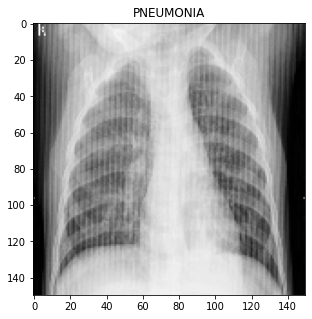

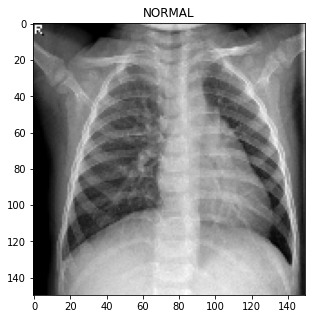

In [ ]:
plt.figure(figsize = (5,5))
plt.imshow(train[0][0], cmap='gray')
plt.title(labels[train[0][1]])

plt.figure(figsize = (5,5))
plt.imshow(train[-1][0], cmap='gray')
plt.title(labels[train[-1][1]])

In [ ]:
x_train = []
y_train = []

x_val = []
y_val = []

x_test = []
y_test = []

for feature, label in train:
    x_train.append(feature)
    y_train.append(label)

for feature, label in test:
    x_test.append(feature)
    y_test.append(label)
    
for feature, label in val:
    x_val.append(feature)
    y_val.append(label)

In [ ]:
# Normalize the data
x_train = np.array(x_train) / 255
x_val = np.array(x_val) / 255
x_test = np.array(x_test) / 255

In [ ]:
# resize data 
x_train = x_train.reshape(-1, img_size, img_size, 1)
y_train = np.array(y_train)

x_val = x_val.reshape(-1, img_size, img_size, 1)
y_val = np.array(y_val)

x_test = x_test.reshape(-1, img_size, img_size, 1)
y_test = np.array(y_test)

In [ ]:
datagen = ImageDataGenerator(
        featurewise_center=False,  
        samplewise_center=False,  
        featurewise_std_normalization=False,  
        samplewise_std_normalization=False,  
        zca_whitening=False,  
        rotation_range = 30,  
        zoom_range = 0.2, # 
        width_shift_range=0.1,  
        height_shift_range=0.1,  
        horizontal_flip = True,  
        vertical_flip=False) 


datagen.fit(x_train)

# **MODEL 1**

In [ ]:
model = Sequential()
model.add(Conv2D(32 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu' , input_shape = (150,150,1)))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Conv2D(64 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
model.add(Dropout(0.1))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Conv2D(64 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Conv2D(128 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
model.add(Dropout(0.2))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Conv2D(256 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
model.add(Dropout(0.2))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Flatten())
model.add(Dense(units = 128 , activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(units = 1 , activation = 'sigmoid'))
model.compile(optimizer = "rmsprop" , loss = 'binary_crossentropy' , metrics = ['accuracy'])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 150, 150, 32)      320       
                                                                 
 batch_normalization (BatchN  (None, 150, 150, 32)     128       
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 75, 75, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 75, 75, 64)        18496     
                                                                 
 dropout (Dropout)           (None, 75, 75, 64)        0         
                                                                 
 batch_normalization_1 (Batc  (None, 75, 75, 64)       2

In [ ]:
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', patience = 2, verbose=1,factor=0.3, min_lr=0.0001)

In [ ]:
history = model.fit(datagen.flow(x_train,y_train, batch_size = 32) ,epochs = 50 , validation_data = datagen.flow(x_val, y_val) ,callbacks = [learning_rate_reduction])

Epoch 1/50
145/145 [==============================] - 29s 121ms/step - loss: 0.6364 - accuracy: 0.8218 - val_loss: 21.0370 - val_accuracy: 0.7305 - lr: 0.0010
Epoch 2/50
145/145 [==============================] - 17s 115ms/step - loss: 0.3284 - accuracy: 0.8749 - val_loss: 29.0509 - val_accuracy: 0.7305 - lr: 0.0010
Epoch 3/50
145/145 [==============================] - ETA: 0s - loss: 0.3236 - accuracy: 0.8979
Epoch 00003: ReduceLROnPlateau reducing learning rate to 0.0003000000142492354.
145/145 [==============================] - 16s 112ms/step - loss: 0.3236 - accuracy: 0.8979 - val_loss: 28.3006 - val_accuracy: 0.7305 - lr: 0.0010
Epoch 4/50
145/145 [==============================] - 16s 111ms/step - loss: 0.2144 - accuracy: 0.9306 - val_loss: 9.8889 - val_accuracy: 0.7305 - lr: 3.0000e-04
Epoch 5/50
145/145 [==============================] - 16s 112ms/step - loss: 0.1869 - accuracy: 0.9367 - val_loss: 0.3298 - val_accuracy: 0.9136 - lr: 3.0000e-04
Epoch 6/50
145/145 [==============

In [ ]:
print("Loss of the model is - " , model.evaluate(x_test,y_test)[0])
print("Accuracy of the model is - " , model.evaluate(x_test,y_test)[1]*100 , "%")

2/2 [==============================] - 1s 295ms/step - loss: 0.2621 - accuracy: 0.9298
Loss of the model is -  0.26205718517303467
2/2 [==============================] - 0s 25ms/step - loss: 0.2621 - accuracy: 0.9298
Accuracy of the model is -  92.98245906829834 %


# **Evaluasi Model 1**

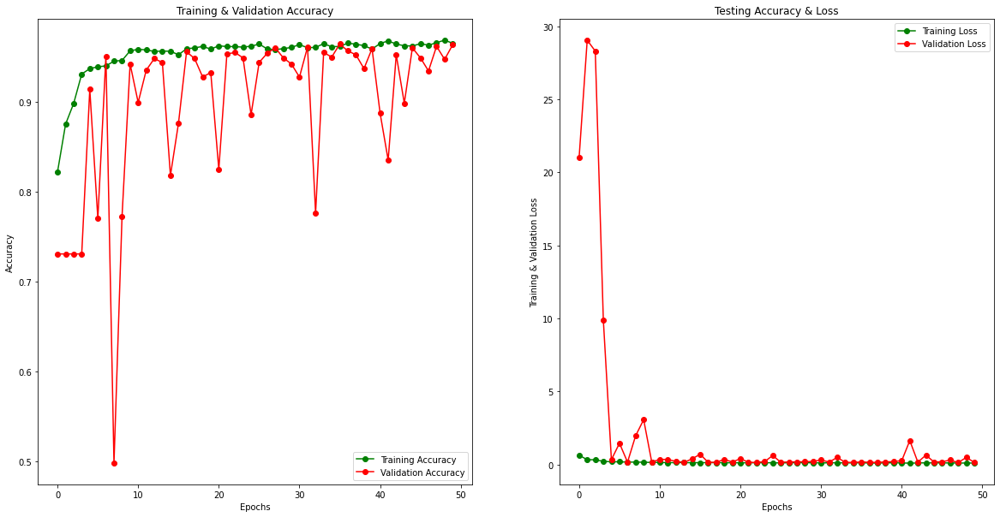

In [ ]:
epochs = [i for i in range(50)]
fig , ax = plt.subplots(1,2)
train_acc = history.history['accuracy']
train_loss = history.history['loss']
val_acc = history.history['val_accuracy']
val_loss = history.history['val_loss']
fig.set_size_inches(20,10)

ax[0].plot(epochs , train_acc , 'go-' , label = 'Training Accuracy')
ax[0].plot(epochs , val_acc , 'ro-' , label = 'Validation Accuracy')
ax[0].set_title('Training & Validation Accuracy')
ax[0].legend()
ax[0].set_xlabel("Epochs")
ax[0].set_ylabel("Accuracy")

ax[1].plot(epochs , train_loss , 'g-o' , label = 'Training Loss')
ax[1].plot(epochs , val_loss , 'r-o' , label = 'Validation Loss')
ax[1].set_title('Testing Accuracy & Loss')
ax[1].legend()
ax[1].set_xlabel("Epochs")
ax[1].set_ylabel("Training & Validation Loss")
plt.show()

In [ ]:
predictions = (model.predict(x_test) > 0.5).astype("int32")
predictions = predictions.reshape(1,-1)[0]
predictions[:15]

array([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], dtype=int32)

In [ ]:
print(classification_report(y_test, predictions, target_names = ['Pneumonia (Class 0)','Normal (Class 1)']))

                     precision    recall  f1-score   support

Pneumonia (Class 0)       1.00      0.90      0.95        42
   Normal (Class 1)       0.79      1.00      0.88        15

           accuracy                           0.93        57
          macro avg       0.89      0.95      0.92        57
       weighted avg       0.94      0.93      0.93        57



In [ ]:
cm = confusion_matrix(y_test,predictions)
cm

array([[38,  4],
       [ 0, 15]])

In [ ]:
import pandas as pd

cm = pd.DataFrame(cm , index = ['0','1'] , columns = ['0','1'])

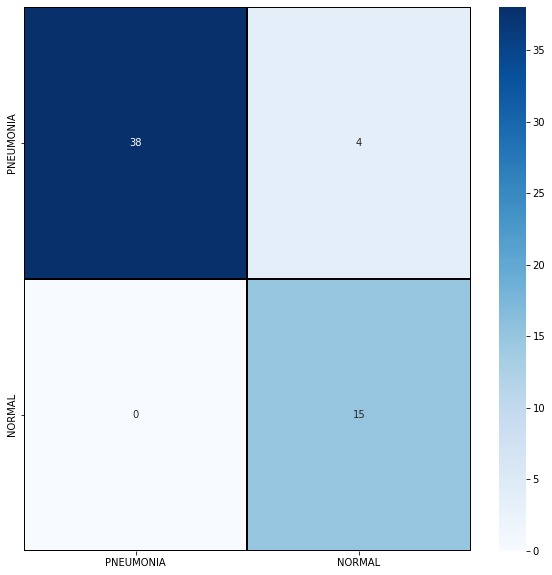

In [ ]:
plt.figure(figsize = (10,10))
sns.heatmap(cm,cmap= "Blues", linecolor = 'black' , linewidth = 1 , annot = True, fmt='',xticklabels = labels,yticklabels = labels)

In [ ]:
correct = np.nonzero(predictions == y_test)[0]
incorrect = np.nonzero(predictions != y_test)[0]

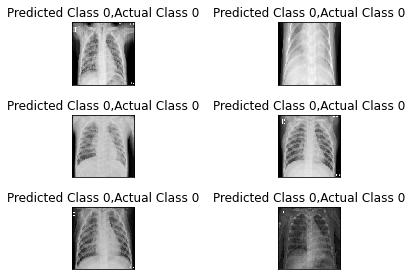

In [ ]:
i = 0
for c in correct[:6]:
    plt.subplot(3,2,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(x_test[c].reshape(150,150), cmap="gray", interpolation='none')
    plt.title("Predicted Class {},Actual Class {}".format(predictions[c], y_test[c]))
    plt.tight_layout()
    i += 1

# **hpram tuning Model 1** 

In [ ]:
import os
import cv2
import numpy as np
from time import time
from tensorflow.keras import utils
from tensorflow.keras.optimizers import Adam, Adadelta
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, BatchNormalization, Dropout, AveragePooling2D
from tensorflow.keras.applications import VGG16
from sklearn.model_selection import train_test_split
from keras.callbacks import ReduceLROnPlateau
from keras.models import Sequential
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import tensorflow as tf
from tensorboard.plugins.hparams import api as hp

In [ ]:
%load_ext tensorboard

In [ ]:
!rm -rf ./logs/ 

In [ ]:
HP_NUM_UNITS = hp.HParam('num_units', hp.Discrete([32]))
HP_DROPOUT = hp.HParam('dropout', hp.RealInterval(0.2, 0.4))
HP_OPTIMIZER = hp.HParam('optimizer', hp.Discrete(['adam', 'sgd']))

METRIC_ACCURACY = 'accuracy'

with tf.summary.create_file_writer('logs/hparam_tuning').as_default():
  hp.hparams_config(
    hparams=[HP_NUM_UNITS, HP_DROPOUT, HP_OPTIMIZER],
    metrics=[hp.Metric(METRIC_ACCURACY, display_name='Accuracy')],
  )

### Definisikan `x_val dan y_val` dari validation data untuk evaluasi model.

In [ ]:
xvl, yvl = zip(*(val_set[i] for i in range(len(val_set))))
x_val, y_val = np.vstack(xvl), np.vstack(yvl)

In [ ]:
def train_test_model(hparams):
  model = Sequential()
  model.add(Conv2D(filters = 32, kernel_size=(3, 3), input_shape = (64, 64, 3))),
  model.add(BatchNormalization()),
  model.add(MaxPooling2D(pool_size=(2,2))),
  model.add(Dropout(hparams[HP_DROPOUT])),
  model.add(Conv2D(filters = 32, kernel_size=(3, 3), input_shape = (64, 64, 3), activation = 'relu')),
  model.add(BatchNormalization()),
  model.add(MaxPooling2D(pool_size=(2,2))),
  model.add(MaxPooling2D(pool_size=(2,2))),
  model.add(Dropout(hparams[HP_DROPOUT])),
  model.add(Conv2D(filters = 32, kernel_size=(3, 3), input_shape = (64, 64, 3), activation = 'relu')),
  model.add(BatchNormalization()),
  model.add(MaxPooling2D(pool_size=(2,2))),
  model.add(MaxPooling2D(pool_size=(2,2))),
  model.add(Dropout(hparams[HP_DROPOUT])),
  model.add(Flatten()),
  model.add(Dense(hparams[HP_NUM_UNITS], activation = 'relu')),
  model.add(Dense(64, activation='relu')),
  model.add(Dense(32, activation='relu')),
  model.add(Dropout(hparams[HP_DROPOUT])),
  model.add(Dense(2, activation='softmax'))

  model.compile(
      optimizer=hparams[HP_OPTIMIZER],
      loss='categorical_crossentropy',
      metrics=['accuracy'],
  )

  model.fit(training_set, 
            validation_data=val_set, 
            epochs=25,
            callbacks=ReduceLROnPlateau(monitor='val_accuracy', patience = 2, verbose=1,factor=0.3, min_lr=0.0001),
  )
  _, accuracy = model.evaluate(x_val, y_val)
  return accuracy

In [ ]:
def run(run_dir, hparams):
  with tf.summary.create_file_writer(run_dir).as_default():
    hp.hparams(hparams)  # record the values used in this trial
    accuracy = train_test_model(hparams)
    tf.summary.scalar(METRIC_ACCURACY, accuracy, step=25)

In [ ]:
session_num = 0

for num_units in HP_NUM_UNITS.domain.values:
  for dropout_rate in (HP_DROPOUT.domain.min_value, HP_DROPOUT.domain.max_value):
    for optimizer in HP_OPTIMIZER.domain.values:
      hparams = {
          HP_NUM_UNITS: num_units,
          HP_DROPOUT: dropout_rate,
          HP_OPTIMIZER: optimizer,
      }
      run_name = "run-%d" % session_num
      print('--- Starting trial: %s' % run_name)
      print({h.name: hparams[h] for h in hparams})
      run('logs/hparam_tuning/' + run_name, hparams)
      session_num += 1

--- Starting trial: run-0
{'num_units': 32, 'dropout': 0.2, 'optimizer': 'adam'}
Epoch 1/25
577/577 [==============================] - 84s 127ms/step - loss: 0.5991 - accuracy: 0.7136 - val_loss: 0.5254 - val_accuracy: 0.7299 - lr: 0.0010
Epoch 2/25
577/577 [==============================] - 71s 123ms/step - loss: 0.5355 - accuracy: 0.7505 - val_loss: 0.4565 - val_accuracy: 0.7889 - lr: 0.0010
Epoch 3/25
577/577 [==============================] - 71s 123ms/step - loss: 0.5004 - accuracy: 0.7739 - val_loss: 0.4462 - val_accuracy: 0.8068 - lr: 0.0010
Epoch 4/25
577/577 [==============================] - 71s 123ms/step - loss: 0.4629 - accuracy: 0.7986 - val_loss: 0.4118 - val_accuracy: 0.8026 - lr: 0.0010
Epoch 5/25
577/577 [==============================] - ETA: 0s - loss: 0.4183 - accuracy: 0.8114
Epoch 00005: ReduceLROnPlateau reducing learning rate to 0.0003000000142492354.
577/577 [==============================] - 71s 124ms/step - loss: 0.4183 - accuracy: 0.8114 - val_loss: 0.4492 

In [ ]:
%tensorboard --logdir logs/hparam_tuning

<IPython.core.display.Javascript object>

# **MODEL 2**

In [ ]:
model2 = Sequential()
model2.add(Conv2D(32 , (3,3) , strides = 1 , padding = 'same' , activation = 'elu' , input_shape = (150,150,1)))
model2.add(BatchNormalization())
model2.add(AveragePooling2D((2,2) , strides = 2 , padding = 'same'))
model2.add(Conv2D(64 , (3,3) , strides = 1 , padding = 'same' , activation = 'elu'))
model2.add(Dropout(0.2))
model2.add(BatchNormalization())
model2.add(AveragePooling2D((2,2) , strides = 2 , padding = 'same'))
model2.add(Conv2D(64 , (3,3) , strides = 1 , padding = 'same' , activation = 'elu'))
model2.add(BatchNormalization())
model2.add(AveragePooling2D((2,2) , strides = 2 , padding = 'same'))
model2.add(Conv2D(128 , (3,3) , strides = 1 , padding = 'same' , activation = 'elu'))
model2.add(Dropout(0.3))
model2.add(BatchNormalization())
model2.add(AveragePooling2D((2,2) , strides = 2 , padding = 'same'))
model2.add(Conv2D(256 , (3,3) , strides = 1 , padding = 'same' , activation = 'elu'))
model2.add(Dropout(0.3))
model2.add(BatchNormalization())
model2.add(AveragePooling2D((2,2) , strides = 2 , padding = 'same'))
model2.add(Flatten())
model2.add(Dense(units = 128 , activation = 'elu'))
model2.add(Dropout(0.3))
model2.add(Dense(units = 1 , activation = 'sigmoid'))
model2.compile(optimizer = "Adam" , loss = 'binary_crossentropy' , metrics = ['accuracy'])
model2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 150, 150, 32)      320       
                                                                 
 batch_normalization_5 (Batc  (None, 150, 150, 32)     128       
 hNormalization)                                                 
                                                                 
 average_pooling2d (AverageP  (None, 75, 75, 32)       0         
 ooling2D)                                                       
                                                                 
 conv2d_6 (Conv2D)           (None, 75, 75, 64)        18496     
                                                                 
 dropout_4 (Dropout)         (None, 75, 75, 64)        0         
                                                                 
 batch_normalization_6 (Batc  (None, 75, 75, 64)      

In [ ]:
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', patience = 2, verbose=1,factor=0.3, min_lr=0.00001)

In [ ]:
history2 = model2.fit(datagen.flow(x_train,y_train, batch_size = 32) ,epochs = 50 , validation_data = datagen.flow(x_val, y_val) ,callbacks = [learning_rate_reduction])

Epoch 1/50
145/145 [==============================] - 18s 112ms/step - loss: 0.5422 - accuracy: 0.7800 - val_loss: 1.0769 - val_accuracy: 0.7305 - lr: 0.0010
Epoch 2/50
145/145 [==============================] - 16s 107ms/step - loss: 0.3764 - accuracy: 0.8351 - val_loss: 2.4486 - val_accuracy: 0.7305 - lr: 0.0010
Epoch 3/50
145/145 [==============================] - ETA: 0s - loss: 0.3219 - accuracy: 0.8661
Epoch 00003: ReduceLROnPlateau reducing learning rate to 0.0003000000142492354.
145/145 [==============================] - 16s 108ms/step - loss: 0.3219 - accuracy: 0.8661 - val_loss: 3.2053 - val_accuracy: 0.7305 - lr: 0.0010
Epoch 4/50
145/145 [==============================] - 16s 108ms/step - loss: 0.2578 - accuracy: 0.8977 - val_loss: 1.8725 - val_accuracy: 0.7322 - lr: 3.0000e-04
Epoch 5/50
145/145 [==============================] - 16s 112ms/step - loss: 0.2354 - accuracy: 0.9053 - val_loss: 0.2106 - val_accuracy: 0.9204 - lr: 3.0000e-04
Epoch 6/50
145/145 [=================

In [ ]:
print("Loss of the model is - " , model2.evaluate(x_test,y_test)[0])
print("Accuracy of the model is - " , model2.evaluate(x_test,y_test)[1]*100 , "%")

2/2 [==============================] - 1s 319ms/step - loss: 0.2062 - accuracy: 0.9123
Loss of the model is -  0.206150621175766
2/2 [==============================] - 0s 31ms/step - loss: 0.2062 - accuracy: 0.9123
Accuracy of the model is -  91.22806787490845 %


# **Evaluasi Model**

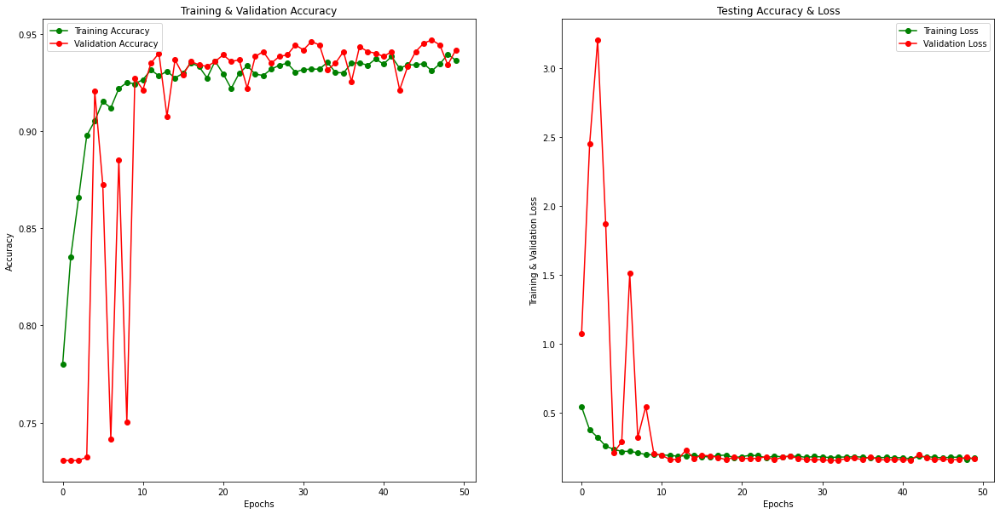

In [ ]:
epochs = [i for i in range(50)]
fig , ax = plt.subplots(1,2)
train_acc = history2.history['accuracy']
train_loss = history2.history['loss']
val_acc = history2.history['val_accuracy']
val_loss = history2.history['val_loss']
fig.set_size_inches(20,10)

ax[0].plot(epochs , train_acc , 'go-' , label = 'Training Accuracy')
ax[0].plot(epochs , val_acc , 'ro-' , label = 'Validation Accuracy')
ax[0].set_title('Training & Validation Accuracy')
ax[0].legend()
ax[0].set_xlabel("Epochs")
ax[0].set_ylabel("Accuracy")

ax[1].plot(epochs , train_loss , 'g-o' , label = 'Training Loss')
ax[1].plot(epochs , val_loss , 'r-o' , label = 'Validation Loss')
ax[1].set_title('Testing Accuracy & Loss')
ax[1].legend()
ax[1].set_xlabel("Epochs")
ax[1].set_ylabel("Training & Validation Loss")
plt.show()

In [ ]:
predictions2 = (model2.predict(x_test) > 0.5).astype("int32")
predictions2 = predictions2.reshape(1,-1)[0]
predictions2[:15]

array([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], dtype=int32)

In [ ]:
print(classification_report(y_test, predictions2, target_names = ['Pneumonia (Class 0)','Normal (Class 1)']))

                     precision    recall  f1-score   support

Pneumonia (Class 0)       0.97      0.90      0.94        42
   Normal (Class 1)       0.78      0.93      0.85        15

           accuracy                           0.91        57
          macro avg       0.88      0.92      0.89        57
       weighted avg       0.92      0.91      0.91        57



In [ ]:
cm2 = confusion_matrix(y_test,predictions2)
cm2

array([[38,  4],
       [ 1, 14]])

In [ ]:
import pandas as pd

cm2 = pd.DataFrame(cm2 , index = ['0','1'] , columns = ['0','1'])

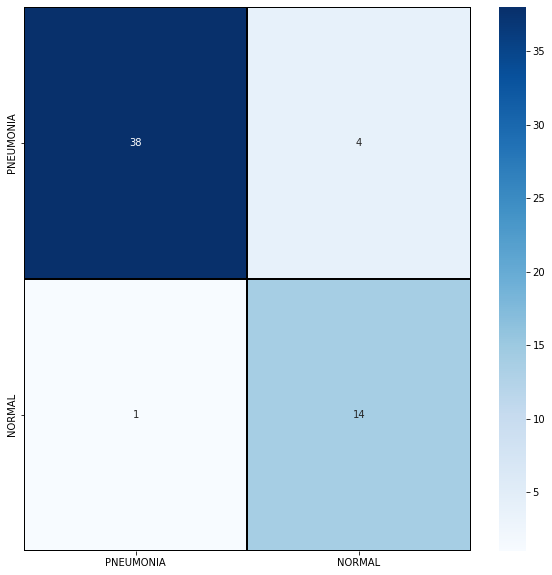

In [ ]:
plt.figure(figsize = (10,10))
sns.heatmap(cm2,cmap= "Blues", linecolor = 'black' , linewidth = 1 , annot = True, fmt='',xticklabels = labels,yticklabels = labels)

In [ ]:
correct2 = np.nonzero(predictions2 == y_test)[0]
incorrect2 = np.nonzero(predictions2 != y_test)[0]

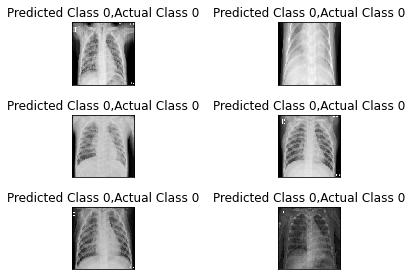

In [ ]:
i = 0
for c in correct[:6]:
    plt.subplot(3,2,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(x_test[c].reshape(150,150), cmap="gray", interpolation='none')
    plt.title("Predicted Class {},Actual Class {}".format(predictions[c], y_test[c]))
    plt.tight_layout()
    i += 1

# **hpram tuning**

In [ ]:
import os
import cv2
import numpy as np
from time import time
from tensorflow.keras import utils
from tensorflow.keras.optimizers import Adam, Adadelta
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, BatchNormalization, Dropout, AveragePooling2D
from tensorflow.keras.applications import VGG16
from sklearn.model_selection import train_test_split
from keras.callbacks import ReduceLROnPlateau
from keras.models import Sequential
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import tensorflow as tf
from tensorboard.plugins.hparams import api as hp

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
!rm -rf ./logs/ 

In [ ]:
HP_NUM_UNITS = hp.HParam('num_units', hp.Discrete([128]))
HP_DROPOUT = hp.HParam('dropout', hp.RealInterval(0.3, 0.5))
HP_OPTIMIZER = hp.HParam('optimizer', hp.Discrete(['adadelta', 'rmsprop']))

METRIC_ACCURACY = 'accuracy'

with tf.summary.create_file_writer('logs/hparam_tuning').as_default():
  hp.hparams_config(
    hparams=[HP_NUM_UNITS, HP_DROPOUT, HP_OPTIMIZER],
    metrics=[hp.Metric(METRIC_ACCURACY, display_name='Accuracy')],
  )

In [ ]:
xvl, yvl = zip(*(val_set[i] for i in range(len(val_set))))
x_val, y_val = np.vstack(xvl), np.vstack(yvl)

In [ ]:
def train_test_model2(hparams):
  model2 = Sequential()
  model2.add(Conv2D(filters = 32, kernel_size=(3, 3), input_shape = (64, 64, 3))),
  model2.add(BatchNormalization()),
  model2.add(AveragePooling2D(pool_size=(2,2))),
  model2.add(Dropout(hparams[HP_DROPOUT])),
  model2.add(Conv2D(filters = 32, kernel_size=(3, 3), input_shape = (64, 64, 3), activation = 'elu')),
  model2.add(BatchNormalization()),
  model2.add(AveragePooling2D(pool_size=(2,2))),
  model2.add(AveragePooling2D(pool_size=(2,2))),
  model2.add(Dropout(hparams[HP_DROPOUT])),
  model2.add(Conv2D(filters = 32, kernel_size=(3, 3), input_shape = (64, 64, 3), activation = 'elu')),
  model2.add(BatchNormalization()),
  model2.add(AveragePooling2D(pool_size=(2,2))),
  model2.add(AveragePooling2D(pool_size=(2,2))),
  model2.add(Dropout(hparams[HP_DROPOUT])),
  model2.add(Flatten()),
  model2.add(Dense(hparams[HP_NUM_UNITS], activation = 'elu')),
  model2.add(Dense(64, activation='elu')),
  model2.add(Dense(32, activation='elu')),
  model2.add(Dropout(hparams[HP_DROPOUT])),
  model2.add(Dense(2, activation='softmax'))

  model2.compile(
      optimizer=hparams[HP_OPTIMIZER],
      loss='categorical_crossentropy',
      metrics=['accuracy'],
  )

  model2.fit(training_set, 
            validation_data=val_set, 
            epochs=25,
            callbacks=ReduceLROnPlateau(monitor='val_accuracy', patience = 2, verbose=1,factor=0.3, min_lr=0.000001),
  )
  _, accuracy = model2.evaluate(x_val, y_val)
  return accuracy

In [ ]:
def run2(run_dir, hparams):
  with tf.summary.create_file_writer(run_dir).as_default():
    hp.hparams(hparams)  # record the values used in this trial
    accuracy = train_test_model2(hparams)
    tf.summary.scalar(METRIC_ACCURACY, accuracy, step=25)

In [ ]:
session_num = 0

for num_units in HP_NUM_UNITS.domain.values:
  for dropout_rate in (HP_DROPOUT.domain.min_value, HP_DROPOUT.domain.max_value):
    for optimizer in HP_OPTIMIZER.domain.values:
      hparams = {
          HP_NUM_UNITS: num_units,
          HP_DROPOUT: dropout_rate,
          HP_OPTIMIZER: optimizer,
      }
      run_name = "run-%d" % session_num
      print('--- Starting trial: %s' % run_name)
      print({h.name: hparams[h] for h in hparams})
      run2('logs/hparam_tuning/' + run_name, hparams)
      session_num += 1

--- Starting trial: run-0
{'num_units': 128, 'dropout': 0.3, 'optimizer': 'adadelta'}
Epoch 1/25
577/577 [==============================] - 73s 125ms/step - loss: 0.7094 - accuracy: 0.5320 - val_loss: 0.6363 - val_accuracy: 0.6128 - lr: 0.0010
Epoch 2/25
577/577 [==============================] - 72s 124ms/step - loss: 0.6885 - accuracy: 0.5651 - val_loss: 0.6217 - val_accuracy: 0.6547 - lr: 0.0010
Epoch 3/25
577/577 [==============================] - 71s 123ms/step - loss: 0.6705 - accuracy: 0.5896 - val_loss: 0.6001 - val_accuracy: 0.6906 - lr: 0.0010
Epoch 4/25
577/577 [==============================] - 72s 124ms/step - loss: 0.6621 - accuracy: 0.6048 - val_loss: 0.5985 - val_accuracy: 0.6932 - lr: 0.0010
Epoch 5/25
577/577 [==============================] - 72s 124ms/step - loss: 0.6557 - accuracy: 0.6126 - val_loss: 0.5841 - val_accuracy: 0.7034 - lr: 0.0010
Epoch 6/25
577/577 [==============================] - 71s 123ms/step - loss: 0.6468 - accuracy: 0.6271 - val_loss: 0.5845 - 

In [ ]:
%tensorboard --logdir logs/hparam_tuning

Reusing TensorBoard on port 6006 (pid 3245), started 2:15:05 ago. (Use '!kill 3245' to kill it.)

<IPython.core.display.Javascript object>